In [ ]:
import pandas as pd
import numpy as np

In [ ]:
df = pd.read_csv("my_data/clustered_data.csv")
df

## Filter groove bottom

In [ ]:
from scipy.optimize import curve_fit
from scipy.signal import find_peaks

def func(x, a, b, c, d):
    # Get x and y axis
    return a*x**3 + b*x**2 + c*x + d

# Filter dataframe
df["bottom"] = False

# Iterate grooves
grooves = df.query("groove != -1").groove.unique()
for g in grooves:
    
    # Subdivide the z axis
    groove_df = df.query(f"groove == {g}")
    x_height, x_edges = np.histogram(groove_df.x, bins=100)
    x_edges = [(x_edges[i], x_edges[i+1]) for i in range(x_height.shape[0])]
    
    for l, u in x_edges:
        # Filter dataframe in that area
        slice_df = df.query(f"groove == {g} and x >= {l} and x <= {u}")
        
        # Curve fit
        params, _ = curve_fit(func, slice_df.y, slice_df.z)
        a, b, c, d = params[0], params[1], params[2], params[3]
        
        # Create curve data
        y = np.linspace(slice_df.y.min(), slice_df.y.max(), 100)
        z = func(y, a, b, c, d)
        
        # Find curve maximum
        peaks, _ = find_peaks(z)
        peaks_y = y[peaks]
        peaks_z = z[peaks]
        
        # Region of acceptance
        peaks_min_z = (peaks_z[0] - 0.002) * np.ones(y.shape[0])
        peaks_max_z = (peaks_z[0] + 0.002) * np.ones(y.shape[0])
        
        # Get idx of accepted datapoints
        accepted_df = slice_df.query(f"z >= {peaks_min_z[0]} and z <= {peaks_max_z[0]}")
        idx = accepted_df.index
        df.loc[idx, "bottom"] = True

In [ ]:
def func(df, a, b, r):
    # Get x and z axis
    x, z = df.x, df.z
    
    return 2*a*x + 2*b*z + r**2 - a**2 - b**2

# Parameters for curve fitting
# groove_df = df.query("groove != -1")
grooves = [g for g in df.groove.unique() if g != -1]
parameters = []

for groove in grooves:
    # Filter dataframe
    groove_df = df.query(f"groove == {groove} and bottom")
    
    # Get x and z components
    x, z = groove_df.x, groove_df.z

    # Curve fitting
    params, _ = curve_fit(func, groove_df, x**2 + z**2, xtol=1e-20)
    parameters.append(params)
   
# Calculate mean parameters 
parameters = np.mean(parameters, axis=0)
parameters

In [ ]:
def func(df, a, b, r):
    # Get x and z axis
    x, z = df.x, df.z
    
    return 2*a*x + 2*b*z + r**2 - a**2 - b**2

# Parameters for curve fitting
# groove_df = df.query("groove != -1")
groove_df = df.query("bottom")
parameters = []

x, z = groove_df.x, groove_df.z

# Curve fitting
params, _ = curve_fit(func, groove_df, x**2 + z**2, xtol=1e-20)
params

In [ ]:
import plotly.graph_objects as go

# Plot circle
angles = np.linspace(0, 2*np.pi, 1000)
circle_x = - params[2] * np.cos(angles) + params[0]
circle_z = - params[2] * np.sin(angles) + params[1]

data = [
    go.Scatter(x=circle_x, y=circle_z, mode="markers", marker=dict(size=2, color="red")),
    go.Scatter(x=groove_df.x, y=groove_df.z, mode="markers", marker=dict(size=2, color="green"))
]
fig = go.Figure(data)
fig.show()

In [ ]:
c = np.array([params[0], params[1]])
r = np.abs(params[1])

In [ ]:
radius = np.sqrt((c[0] - df.x)**2 + (c[1] - df.z)**2)
depth = (radius.max() - radius) * 1000
depth.hist(bins=100)

In [ ]:
df["my_depth"] = depth

In [ ]:
df.query("groove == 1").my_depth.hist(bins=100)

In [ ]:
df.query("groove == -1").my_depth.hist(bins=100)

## Difference pdf estimation

In [ ]:
from scipy.stats import gaussian_kde

# Get depth kde for each groove
groove_kdes = {}
for groove in df.groove.unique():
    
    # Filter dataset
    groove_df = df.query(f"groove == {groove}")
    
    # Compute and store kde
    kde = gaussian_kde(groove_df.my_depth)
    groove_kdes[groove] = kde
    
# Get surface kde separately
surface_kde = groove_kdes.pop(-1)

In [ ]:
# Define random state for reproducibility
random_state = 42

# Define number of data points to sample for each kde
n_samples = 10000

# Sample from surface kde
surface_samples = surface_kde.resample(n_samples, random_state).reshape(-1)

# Sample each groove
groove_samples = {g: kde.resample(n_samples, random_state).reshape(-1) for g, kde in groove_kdes.items()}

# Get the sample difference per groove
groove_diff = {g: g_samples - surface_samples for g, g_samples in groove_samples.items()}

In [ ]:
# Transform groove diff dict into dataframe
depth_diff_df = {
    "groove": np.concatenate([g*np.ones(s.shape[0], dtype="int64") for g, s in groove_diff.items()]),
    "diff": np.concatenate([s for s in groove_diff.values()])
}
depth_diff_df = pd.DataFrame(depth_diff_df)
depth_diff_df

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

palette = {0: "blue", 1: "black", 2: "red"}
sns.kdeplot(data=depth_diff_df, x="diff", hue="groove", palette=palette, linewidth=2)
plt.xlim(0, 10)
plt.show()

# OPEN3D

In [1]:
import plotly.graph_objects as go
import open3d as o3d
import pandas as pd
import numpy as np

# Import point cloud
pcd = o3d.io.read_point_cloud("data/depth-mono.xyz")
points = np.asarray(pcd.points)

# Turn into dataframe
pcd_df = pd.DataFrame(points, columns=["x", "y", "z"])

# Plot data
data = go.Scatter3d(x=pcd_df.x, y=pcd_df.y, z=pcd_df.z, mode="markers", marker=dict(size=0.5))
fig = go.Figure(data=data)
fig.show()

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [2]:
# Voxel downsample points
down_pcd = pcd.voxel_down_sample(voxel_size=1e-3)
down_points = np.asarray(down_pcd.points)

# Turn into dataframe
down_df = pd.DataFrame(down_points, columns=["x", "y", "z"])

# Plot data
data = go.Scatter3d(x=down_df.x, y=down_df.y, z=down_df.z, mode="markers", marker=dict(size=0.5))
fig = go.Figure(data=data)
fig.show()

In [3]:
# Calculate normals of downsampled point cloud
down_pcd.estimate_normals(search_param=o3d.geometry.KDTreeSearchParamHybrid(radius=0.1, max_nn=30))
normals = np.asarray(down_pcd.normals)
(normals**2).sum() / normals.shape[0]

1.0000000000000002

In [4]:
# Add normals to pandas DataFrame
down_df["nx"] = normals[:,0]
down_df["ny"] = normals[:,1]
down_df["nz"] = normals[:,2]

In [5]:
# Get normals
normals = down_df[["nx", "ny", "nz"]].values

# Get unit vector in y direction
ey = np.array([0, 1, 0])

# Calculate normal dot products with unit vector
dots = np.dot(normals, ey)
dots.shape

(65602,)

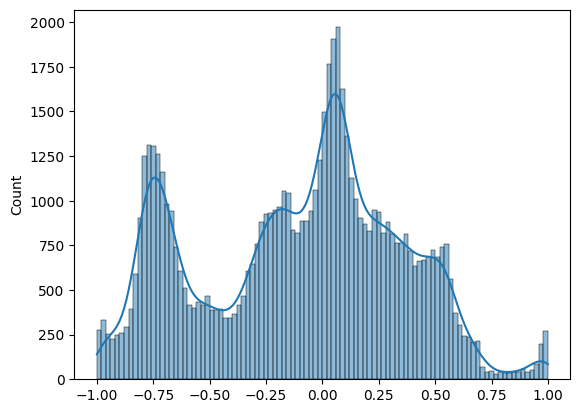

In [6]:
import matplotlib.pyplot as plt
import seaborn as sns

# Print histogram of dot products
sns.histplot(x=dots, bins=100, kde=True)
plt.show()

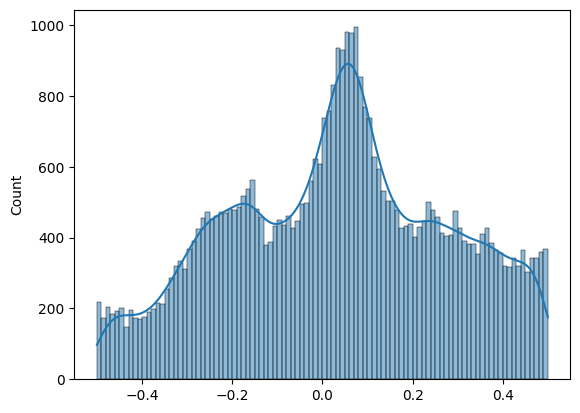

In [7]:
# Filter datapoints according to 30 degree angle
angle = np.pi / 6
max_dot = np.sin(angle)

# Get datapoints that have dot products between this range
idx = np.where((dots < max_dot) & (dots > -max_dot))
filtered_dots = dots[idx]

# Plot histogram of filtered dots
sns.histplot(x=filtered_dots, bins=100, kde=True)
plt.show()

In [8]:
# Get filtered dataframe
df_idx = down_df.index[idx]
filtered_df = down_df.loc[df_idx, :]

# Make scatter plot of filtered dataframe
data = go.Scatter3d(x=filtered_df.x, y=filtered_df.y, z=filtered_df.z, mode="markers", marker=dict(size=0.5))
fig = go.Figure(data=data)
fig.show()

In [9]:
from sklearn.cluster import DBSCAN

model = DBSCAN(eps=1e-3, min_samples=100)
model.fit(filtered_df.y.values.reshape(-1, 1))

unique, counts = np.unique(model.labels_, return_counts=True)
results = pd.DataFrame(np.vstack([unique, counts]).T, columns=["groove", "count"])
results

,groove,count
0,-1,313
1,0,6173
2,1,5297
3,2,18447
4,3,1766
5,4,9596
6,5,1194
7,6,1446


In [10]:
import plotly.express as px

# Create clustered data
clustered_df = filtered_df.copy()
clustered_df["cluster"] = model.labels_

# Make data categorical for plot
plot_df = clustered_df.copy()
plot_df.loc[:, "cluster"] = plot_df["cluster"].apply(str)
fig = px.scatter_3d(plot_df, x="x", y="y", z="z", color="cluster", title="clustered tire")
fig.update_traces(marker_size=0.5)
fig.update_layout(legend={'itemsizing': 'constant'})
fig.show()

In [11]:
from scipy.optimize import fmin_slsqp

def residual(normal):
    # Get dataframe normals
    normals = clustered_df[["nx", "ny", "nz"]].values
    # Calculate dot product between them
    resids = np.dot(normals, normal)
    # Calculate least squares
    resid = (resids**2).sum()
    return resid

def constraint(normal):
    # The normal vector should be unitary
    norm = (normal**2).sum()
    resid = 1 - norm
    return resid
   
# Best orientation
axis_vec = fmin_slsqp(residual, [0,1,0], [constraint], acc=1e-12)
axis_vec

Optimization terminated successfully    (Exit mode 0)
            Current function value: 2565.7437245575475
            Iterations: 7
            Function evaluations: 38
            Gradient evaluations: 7


array([ 0.07606726,  0.99679736, -0.02467359])

In [12]:
def project(point, normal, center=np.array([0,0,0])):
    # Calculate vector from center to point
    point = point - center
    # Calculate length of paralel component
    dist = np.dot(point, normal)
    # Remove paralel component
    point = point - dist * normal
    return point

# Get perpendicular arrays
u, v = project(np.array([1,0,0]), axis_vec), project(np.array([0,0,1]), axis_vec)
u, v = u / np.sqrt((u**2).sum()), v / np.sqrt((v**2).sum())
u, v

(array([ 0.99710269, -0.07604397,  0.00188231]),
 array([0.00187742, 0.02460206, 0.99969556]))

In [15]:
# Filter dataframe according to best fitting clusters
clusters = [0, 1]

# Calculate projected points
circle_df = clustered_df.query(f"cluster in {clusters}")
proj_points = np.array([project(p, axis_vec) for p in circle_df[["x","y","z"]].values])

# Calculate u and v coefficients
a, b = np.dot(proj_points, u), np.dot(proj_points, v)
uv_points = np.stack([a, b], axis=1)
uv_points

array([[ 0.00087998,  0.28898974],
       [ 0.14695115,  0.39418677],
       [ 0.04553546,  0.309177  ],
       ...,
       [-0.11102176,  0.26918628],
       [-0.1086688 ,  0.26908075],
       [-0.10750219,  0.26908295]])

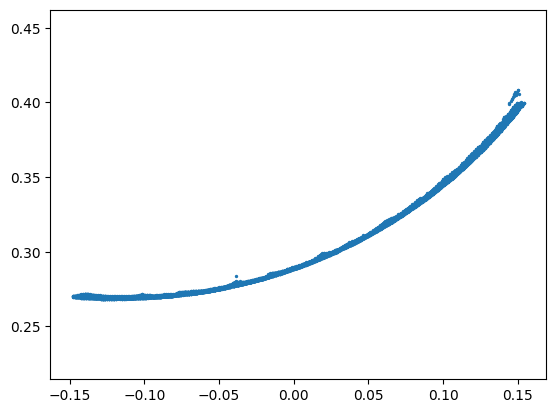

In [17]:
plt.scatter(uv_points[:,0], uv_points[:,1], s=2)
plt.axis("equal")
plt.show()

In [20]:
from scipy.optimize import curve_fit

# Fit circle to data
def circle_fit(X, y):
    # Function to fit to circle data
    f = lambda x, x0, y0, r: 2*x0*x + 2*y0*y + r**2 - x0**2 - y0**2
    
    # Get the A, B, C fitted parameters
    params, _ = curve_fit(f, X, X**2 + y**2, ftol=1e-12)
    x0, y0, r = params
    
    # Determine center and radius from parameters
    c, r = np.array([x0, y0]), np.abs(r)
    
    return c, r

# Calculate center and radius
c, r = circle_fit(uv_points[:,0], uv_points[:,1])

# Convert center coordinates to xyz coordinates
c = c[0] * u + c[1] * v
c, r

(array([-0.11119832,  0.02341911,  0.60329903]), 0.3343088288511947)

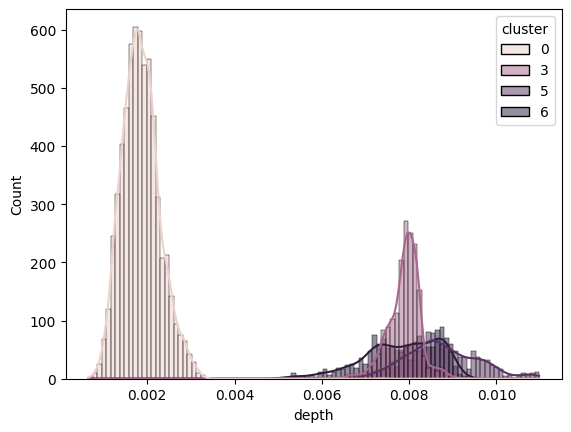

In [24]:
# Calculate radius to each datapoint
crosses = np.array([np.cross(axis_vec, c - p) for p in clustered_df[["x","y","z"]].values])
dists = np.sqrt((crosses**2).sum(axis=-1))
depths = dists.max() - dists

# Add depths to dataframe
clustered_df["depth"] = depths

# Make clusters filter
clusters = [0, 3, 5, 6]
plot_df = clustered_df.query(f"cluster in {clusters}")

# Make histogram
sns.histplot(data=plot_df, x="depth", hue="cluster", bins=100, kde=True)
plt.show()